In [1]:
import os
import matplotlib.pyplot as plt

# Path to the main directory
base_dir = "test_api"


# Function to gather images
def collect_images(base_dir):
    real_images = []
    ai_images_dict = {}

    # Iterate through each category and subcategory to gather real and AI image paths
    for root, dirs, files in os.walk(base_dir):
        root = os.path.normpath(root)

        if "AI" not in root:  # Only gather real images in root paths
            for file in files:
                real_images.append(os.path.join(root, file))
        else:  # Gather AI images from AI subdirectories
            ai_dir_key = os.path.dirname(root).replace("\\", "/")

            if ai_dir_key not in ai_images_dict:
                ai_images_dict[ai_dir_key] = {}

            for file in files:
                parts = file.split("_")

                # The model name will be the first few parts (e.g., "Leonardo_Kino")
                model_name = "_".join(parts[:2])

                # The variation number is at the end before the file extension
                col_num = parts[-1]

                if model_name not in ai_images_dict[ai_dir_key]:
                    ai_images_dict[ai_dir_key][model_name] = {}

                if col_num not in ai_images_dict[ai_dir_key][model_name]:
                    ai_images_dict[ai_dir_key][model_name][col_num] = []

                ai_images_dict[ai_dir_key][model_name][col_num].append(
                    os.path.join(root, file).replace("\\", "/")
                )

    return real_images, ai_images_dict


real_images, ai_images_dict = collect_images(base_dir)

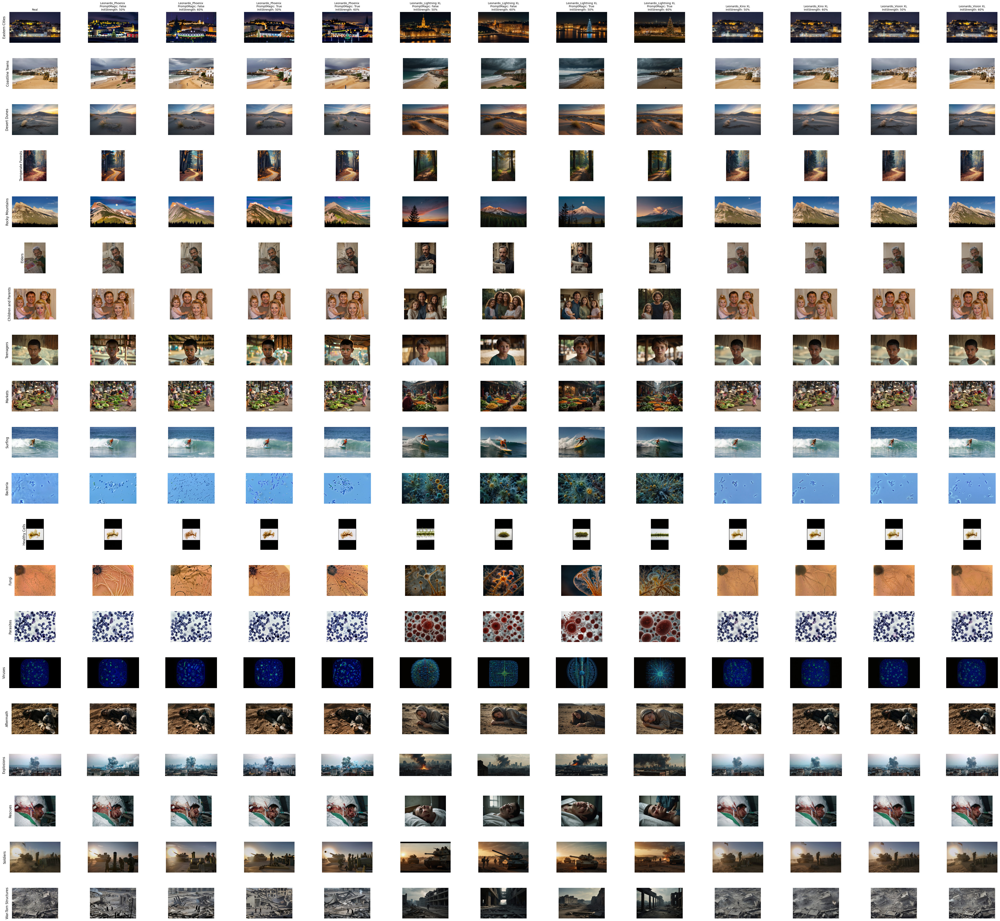

In [63]:
from PIL import Image

# Titles for columns
titles = [
    ("Real", "", ""),
    ("Leonardo_Phoenix", "\nPromptMagic: False\nInitStrength: 50%", "0.jpg"),
    ("Leonardo_Phoenix", "\nPromptMagic: False\nInitStrength: 60%", "1.jpg"),
    ("Leonardo_Phoenix", "\nPromptMagic: True\nInitStrength: 50%", "2.jpg"),
    ("Leonardo_Phoenix", "\nPromptMagic: True\nInitStrength: 60%", "3.jpg"),
    ("Leonardo_Lightning", "XL\nPromptMagic: False\nInitStrength: 50%", "0.jpg"),
    ("Leonardo_Lightning", "XL\nPromptMagic: False\nInitStrength: 60%", "1.jpg"),
    ("Leonardo_Lightning", "XL\nPromptMagic: True\nInitStrength: 50%", "2.jpg"),
    ("Leonardo_Lightning", "XL\nPromptMagic: True\nInitStrength: 60%", "3.jpg"),
    ("Leonardo_Kino", "XL\nInitStrength: 50%", "0.jpg"),
    ("Leonardo_Kino", "XL\nInitStrength: 60%", "1.jpg"),
    ("Leonardo_Vision", "XL\nInitStrength: 50%", "0.jpg"),
    ("Leonardo_Vision", "XL\nInitStrength: 60%", "1.jpg"),
]

row_titles = [
    "Eastern Cities",
    "Coastline Towns",
    "Desert Dunes",
    "Temperate Forests",
    "Rocky Mountains",
    "Elders",
    "Children and Parents",
    "Teenagers",
    "Markets",
    "Surfing",
    "Bacteria",
    "Healthy Cells",
    "Fungi",
    "Parasites",
    "Viruses",
    "Aftermath",
    "Explosions",
    "Rescues",
    "Soldiers",
    "War-Torn Structures",
]


def display_images(real_images, ai_images_dict, titles, row_titles):
    num_rows = len(real_images)
    num_cols = len(titles)

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(5.0 * num_cols, 3 * num_rows))
    fig.subplots_adjust(hspace=0.5, wspace=0.5)

    for col, (model_name, params, variation) in enumerate(titles):
        title = f"{model_name} {params}" if model_name != "Real" else "Real"
        axs[0, col].set_title(title, fontsize=10)

    for row, (real_img_path, row_title) in enumerate(zip(real_images, row_titles)):
        axs[row, 0].text(
            -0.1,
            0.5,
            row_title,
            va="center",
            ha="center",
            rotation=90,
            fontsize=12,
            transform=axs[row, 0].transAxes,
        )
        axs[row, 0].axis("off")

        img_real = Image.open(real_img_path)
        axs[row, 0].imshow(img_real)
        axs[row, 0].axis("off")

        ai_dir_key = os.path.dirname(real_img_path).replace("\\", "/")
        if ai_dir_key in ai_images_dict:
            for col in range(1, num_cols):
                model_name, params, col_num = titles[col]
                ai_imgs = ai_images_dict[ai_dir_key][model_name].get(col_num, [])

                if ai_imgs:
                    ai_img_path = ai_imgs[0]
                    img_ai = Image.open(ai_img_path)
                    axs[row, col].imshow(img_ai)
                else:
                    print(f"Missing AI image for '{ai_dir_key}' in col '{titles[col]}'")
                axs[row, col].axis("off")

    plt.show()


# Run display function
display_images(real_images, ai_images_dict, titles, row_titles)

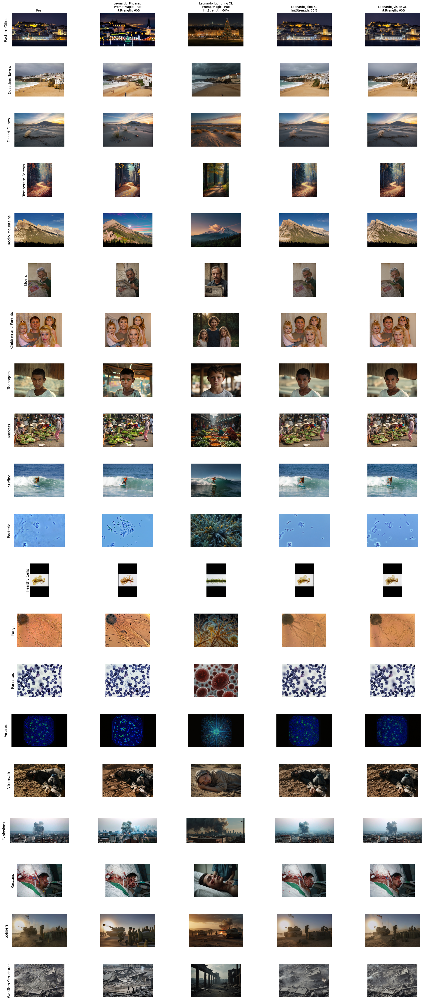

In [62]:
titles = [
    ("Real", "", ""),
    ("Leonardo_Phoenix", "\nPromptMagic: True\nInitStrength: 60%", "3.jpg"),
    ("Leonardo_Lightning", "XL\nPromptMagic: True\nInitStrength: 60%", "3.jpg"),
    ("Leonardo_Kino", "XL\nInitStrength: 60%", "1.jpg"),
    ("Leonardo_Vision", "XL\nInitStrength: 60%", "1.jpg"),
]
display_images(real_images, ai_images_dict, titles, row_titles)

[('GranularImageCategories/Life-and-Portraits/Culture/NorthAmerica/45585398861_c3c72326f1.jpg', 'AI/GranularImageCategories/Life-and-Portraits/Culture/NorthAmerica/Leonardo_Vision_XL_The_image_is_a_bronze_statue_of_a_couple_si_0.jpg'), ('GranularImageCategories/WarTornScenery/WarTornStructures/MiddleEast/14642426218_16a739d381_o.jpg', 'AI/GranularImageCategories/WarTornScenery/WarTornStructures/MiddleEast/Leonardo_Vision_XL_The_image_shows_a_father_and_his_son_standi_0.jpg'), ('GranularImageCategories/Life-and-Portraits/Children/PreTeens/23603650201_5621417dfd.jpg', 'AI/GranularImageCategories/Life-and-Portraits/Children/PreTeens/Leonardo_Vision_XL_The_image_is_a_portrait_of_two_young_girls_0.jpg'), ('GranularImageCategories/Life-and-Portraits/CAA/CAP/6970382786_398f30ba1f_o.jpg', 'AI/GranularImageCategories/Life-and-Portraits/CAA/CAP/Leonardo_Vision_XL_The_image_shows_a_father_and_his_young_son_0.jpg'), ('GranularImageCategories/Landscapes-and-Environments/Deserts/Dunes/31135788702_ff

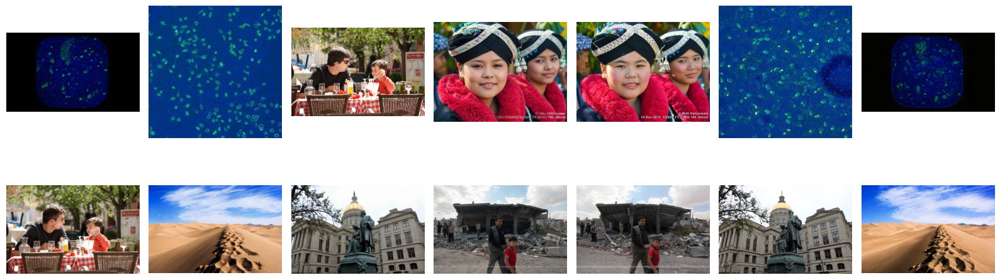

In [ ]:
import os
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from analytics.main_manifest import MAIN_MANIFEST


keys = list(MAIN_MANIFEST.keys())
sample_indices = random.sample(range(len(keys)), 7)
sampled_pairs = [(keys[i], MAIN_MANIFEST[keys[i]]) for i in sample_indices]
print(sampled_pairs)

images = []
for real_path, ai_path in sampled_pairs:
    real_img_path = os.path.abspath(real_path)
    ai_img_path = os.path.abspath(ai_path)
    try:
        real_img = Image.open(real_img_path)
        print(f"opened real path - {real_img_path}")
        ai_img = Image.open(ai_img_path)
        print(f"opened ai path- {ai_img_path}")
        images.extend([real_img, ai_img])

    except FileNotFoundError as e:
        print(e)
        continue


# Shuffle images more effectively
random.shuffle(images)  # Initial shuffle

# Create a 2D grid of random indices for placement
indices = list(range(len(images)))
np.random.shuffle(indices)  # Shuffle the indices randomly

fig, axes = plt.subplots(7, 2, figsize=(16, 6))
axes = axes.flatten()

for ax, img in zip(axes, images):
    ax.imshow(img)
    ax.axis("off")

plt.tight_layout()
plt.show()